/home/user/conda/lib/python3.7/site-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ../torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


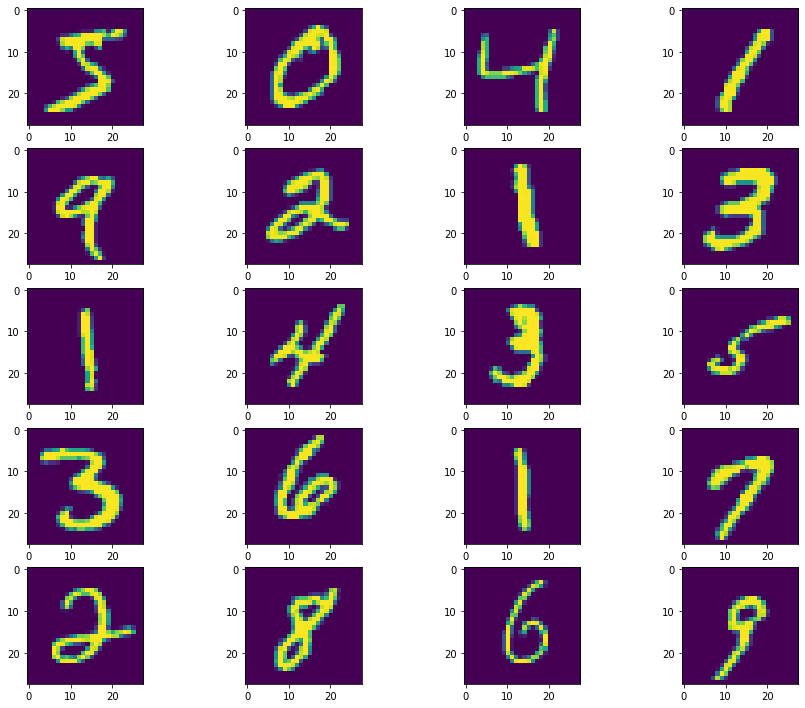

In [1]:
import torch
import torchvision
import matplotlib.pyplot as plt


def show_images(datset, num_samples=20, cols=4):
    """ Plots some samples from the dataset """
    plt.figure(figsize=(15,15))
    for i, img in enumerate(data):
        if i == num_samples:
            break
        plt.subplot(int(num_samples/cols) + 1, cols, i + 1)
        plt.imshow(img[0])


data = torchvision.datasets.MNIST(root="./", download=True)
show_images(data)

In [2]:
import torch.nn.functional as F

In [3]:
from torchvision import transforms
from torch.utils.data import DataLoader
import numpy as np
from sklearn.model_selection import train_test_split

IMG_SIZE = 32
BATCH_SIZE = 16

def load_transformed_dataset():
    data_transforms = [
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
#         transforms.RandomHorizontalFlip(),
        transforms.ToTensor(), # Scales data into [0,1]
#         transforms.Lambda(lambda x: torch.cat([x, x, x], 0)),
        transforms.Lambda(lambda t: (t * 2) - 1) # Scale between [-1, 1]
    ]
    data_transform = transforms.Compose(data_transforms)

    dataset = torchvision.datasets.MNIST(root=".", download=True,
                                         transform=data_transform)
    
    train_ids, test_ids = train_test_split([i for i in range(len(dataset))], test_size=0.1, random_state=42)
    
    train = torch.utils.data.Subset(dataset, train_ids)
    
    test = torch.utils.data.Subset(dataset, test_ids)

    # test = torchvision.datasets.MNIST(root=".", download=True,
    #                                      transform=data_transform, split='test')
    return train, test


def show_tensor_image(image):
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),
        transforms.Lambda(lambda t: t.permute(1, 2, 0)), # CHW to HWC
        transforms.Lambda(lambda t: t * 255.),
        transforms.Lambda(lambda t: t.numpy().astype(np.uint8)),
        transforms.ToPILImage(),
    ])

    # Take first image of batch
    if len(image.shape) == 4:
        image = image[0, :, :, :]
    plt.imshow(reverse_transforms(image), cmap='gray')

    
train_dataset, test_dataset = load_transformed_dataset()
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)
test_dataloader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)

In [16]:
len(train_dataset), len(test_dataset)

(54000, 6000)

In [4]:
!git clone https://github.com/openai/improved-diffusion
!mv improved-diffusion/improved_diffusion ./

fatal: destination path 'improved-diffusion' already exists and is not an empty directory.


In [ ]:
! pip install -e improved-diffusion

In [5]:
from improved_diffusion.unet import UNetModel

model = UNetModel(
    in_channels=1, 
    model_channels=64, 
    out_channels=1,
    num_res_blocks=3, 
    attention_resolutions=("16",)
)
model

UNetModel(
  (time_embed): Sequential(
    (0): Linear(in_features=64, out_features=256, bias=True)
    (1): SiLU()
    (2): Linear(in_features=256, out_features=256, bias=True)
  )
  (input_blocks): ModuleList(
    (0): TimestepEmbedSequential(
      (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
    (1): TimestepEmbedSequential(
      (0): ResBlock(
        (in_layers): Sequential(
          (0): GroupNorm32(32, 64, eps=1e-05, affine=True)
          (1): SiLU()
          (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        )
        (emb_layers): Sequential(
          (0): SiLU()
          (1): Linear(in_features=256, out_features=64, bias=True)
        )
        (out_layers): Sequential(
          (0): GroupNorm32(32, 64, eps=1e-05, affine=True)
          (1): SiLU()
          (2): Dropout(p=0, inplace=False)
          (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        )
        (skip_connection): Ide

# Ну вот вроде как наш лосс 

<img src="https://latex.codecogs.com/gif.latex?x_t = t * x_1 + (1 - t) * x_0"/> </br>
Лосс
<img src="https://latex.codecogs.com/gif.latex?||f_{\theta }(x_t, t) - (x_1 - x_0)|| ^ 2" /> 

In [6]:
def get_loss(model, x_0, x_1, t):
    t = t.unsqueeze(1).unsqueeze(1).unsqueeze(1)
    x_t = t * x_1 + (1 - t) * x_0
    t = t.flatten()
    noise_pred = model(x_t, t)
    
    return F.mse_loss(noise_pred, (x_1 - x_0), reduction="sum")

In [7]:
def euler_integration(net, x0):
    model.eval()
    
    eps = 1e-8
    n_steps = 100
    t = torch.linspace(eps, 1 - eps, n_steps + 1).to(x0.device)

    plt.figure(figsize=(10, 4))
    plt.axis('off')
    num_images = 10
    stepsize = int(n_steps / num_images)

    for i in range(1, len(t)):
        with torch.no_grad():
            t_prev = t[i - 1].unsqueeze(0)
#             print(x0.shape, t_prev.shape)
            f_eval = net(x0, t_prev)
        x = x0 + (t[i] - t[i - 1]) * f_eval
        x0 = x
        
        if i % stepsize == 0 or i == (len(t) - 1):
            plt.subplot(1, num_images, int(i / stepsize))
            show_tensor_image(x.detach().cpu())
    plt.show()
    return x

In [8]:
def train_epoch(model, dataloader, device):
    model.to(device)
    model.train()

    total_loss = 0.0
    for batch in tqdm(dataloader):
        optimizer.zero_grad()

        t = torch.tensor(np.random.uniform(size=(BATCH_SIZE)), dtype=torch.float32).to(device)

        x_1 = batch[0].to(device)
        x_0 = destroy_bottom(x_1)
        
        loss = get_loss(model, x_0, x_1, t)
        loss.backward()
        optimizer.step()
        
        total_loss += loss.item()
        
    return total_loss / len(dataloader.dataset)


def eval_epoch(model, dataloader, device):
    model.to(device)
    model.eval()

    total_loss = 0.0
    for batch in tqdm(dataloader):

        t = torch.tensor(np.random.uniform(size=(BATCH_SIZE)), dtype=torch.float32).to(device)

        x_1 = batch[0].to(device)
        x_0 = destroy_bottom(x_1)
        
        with torch.no_grad():
            loss = get_loss(model, x_0, x_1, t)
        
        total_loss += loss.item()
        
    return total_loss / len(dataloader.dataset)

In [9]:
from copy import deepcopy

def destroy_bottom(x):
    B, C, H, W = x.shape
    x_2 = deepcopy(x)
    noise = torch.tensor(np.random.normal(size=(B, C, H // 2, W)), dtype=torch.float32).to(x_2.device)
    x_2[:, :, H // 2:, :] = noise
    
    return x_2

In [10]:
train_dataset[0][0].unsqueeze(0).shape

torch.Size([1, 1, 32, 32])

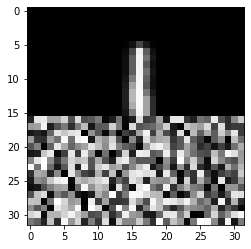

In [11]:
show_tensor_image(destroy_bottom(train_dataset[0][0].unsqueeze(0)))

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 0 | Train Loss: 39.381589161060475 Eval Loss: 38.85087642415365 


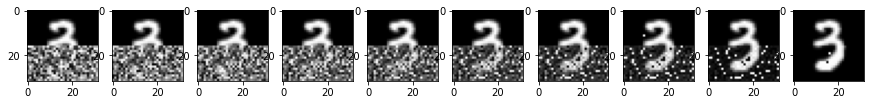

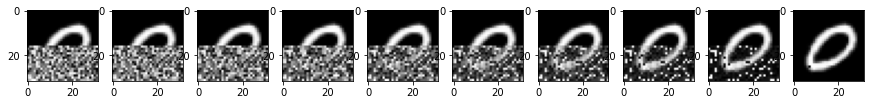

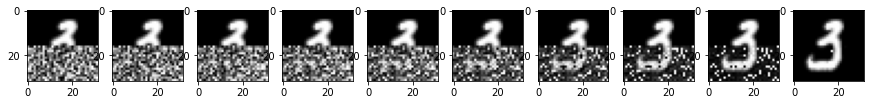

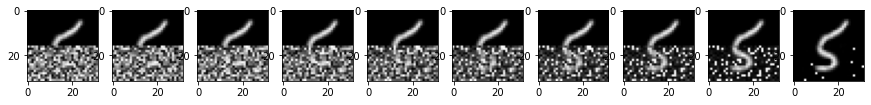

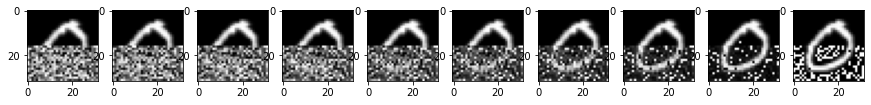

...

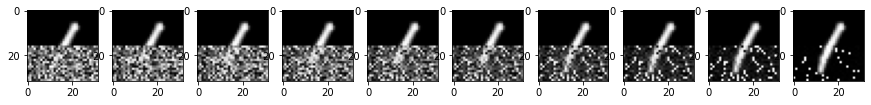

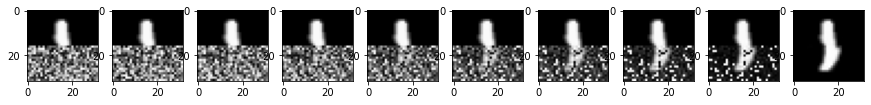

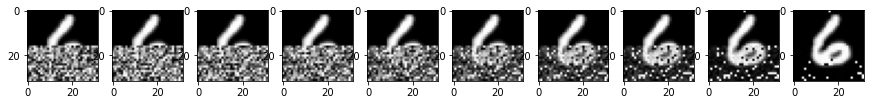

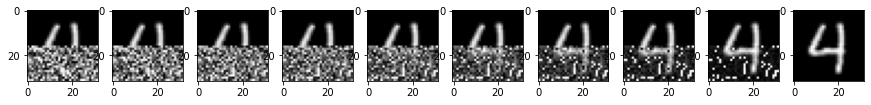

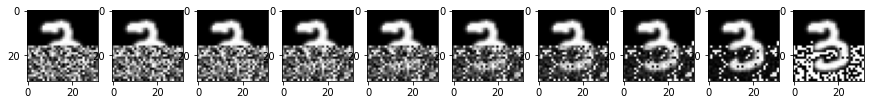

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 1 | Train Loss: 39.16925768590856 Eval Loss: 40.27569045003255 


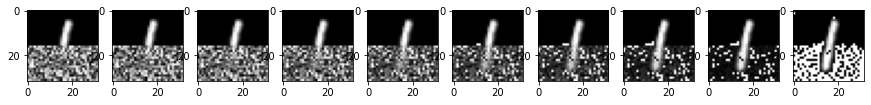

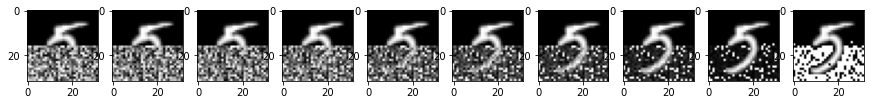

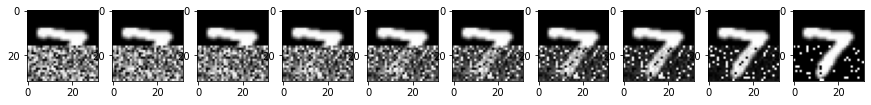

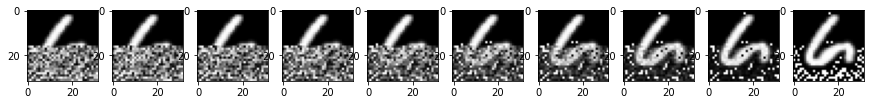

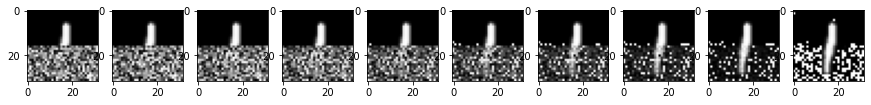

...

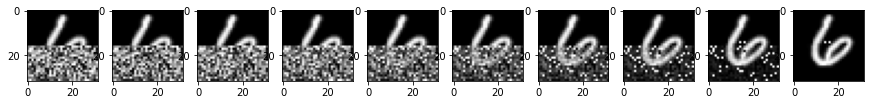

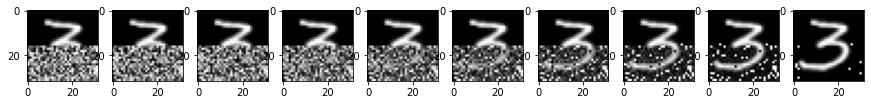

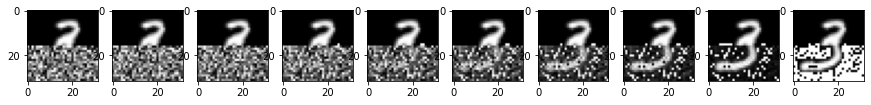

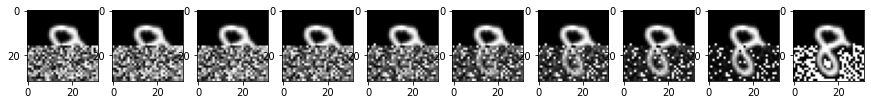

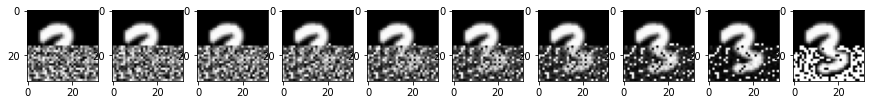

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 2 | Train Loss: 39.01242612372504 Eval Loss: 39.9900798441569 


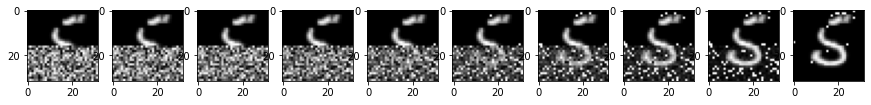

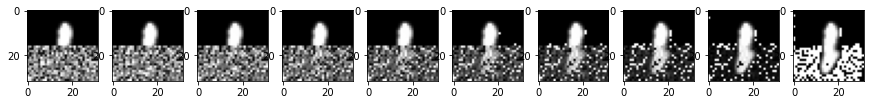

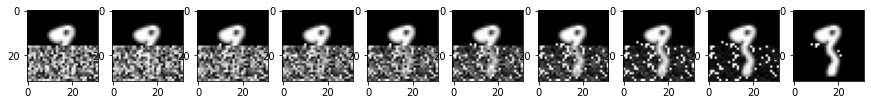

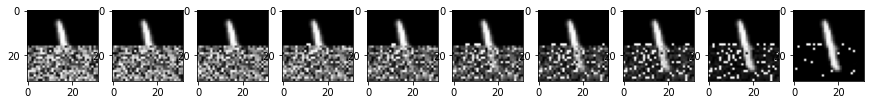

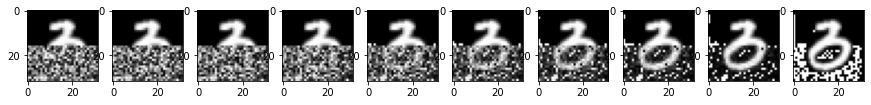

...

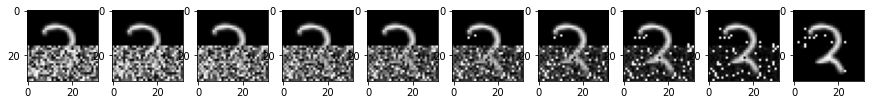

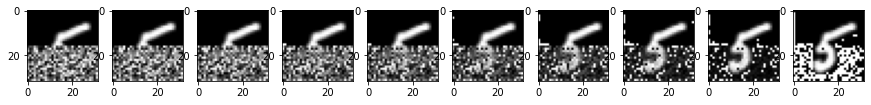

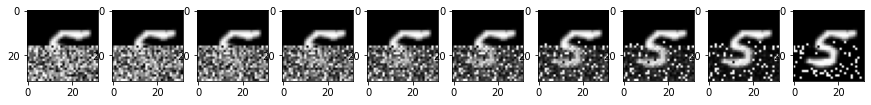

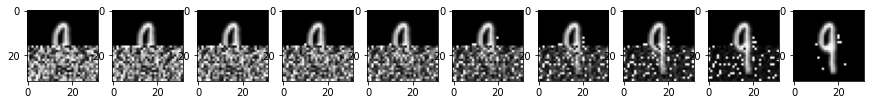

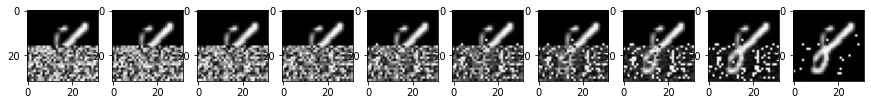

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 3 | Train Loss: 38.81122922092014 Eval Loss: 40.75965953572591 


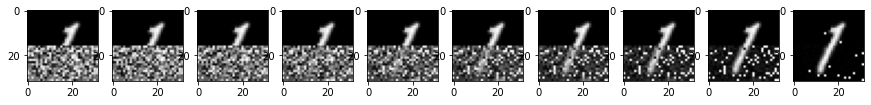

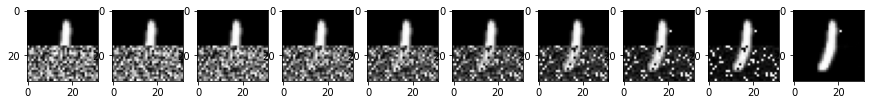

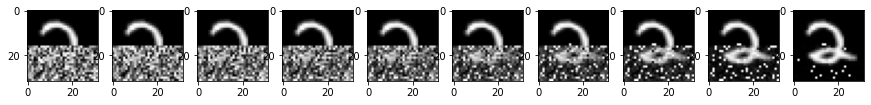

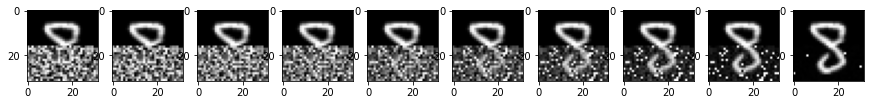

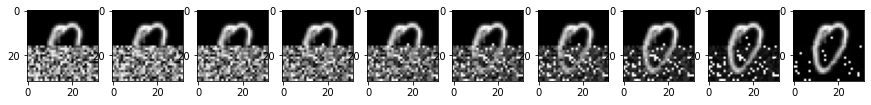

...

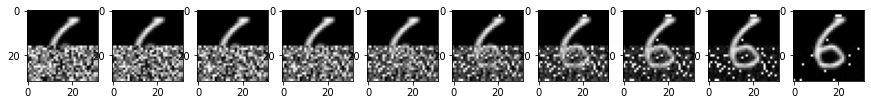

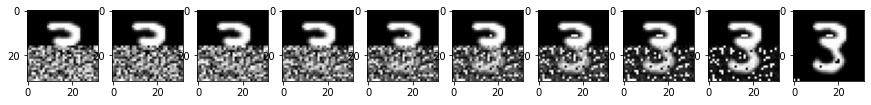

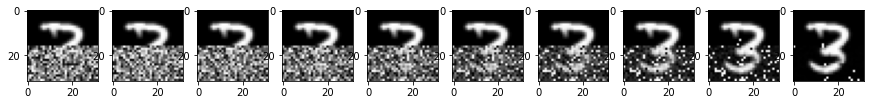

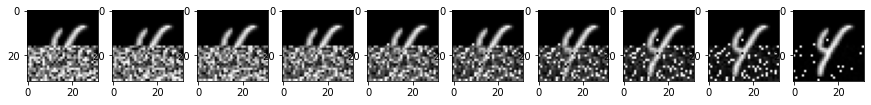

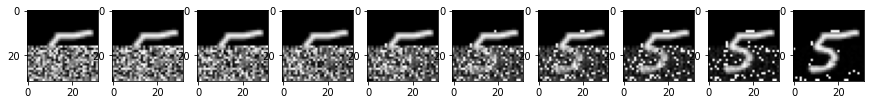

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 4 | Train Loss: 38.555564463862666 Eval Loss: 38.899221552530925 


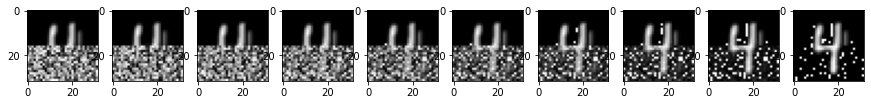

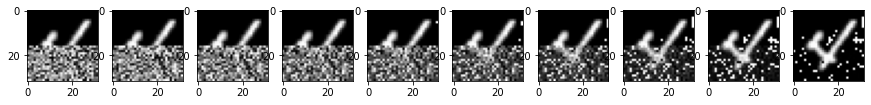

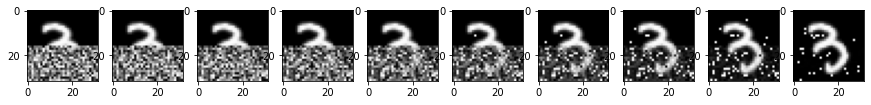

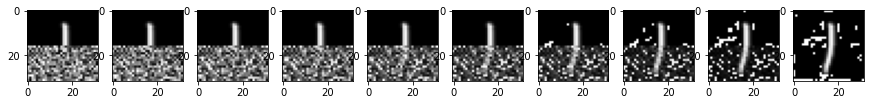

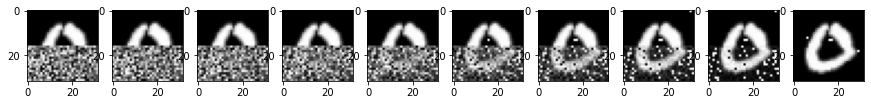

...

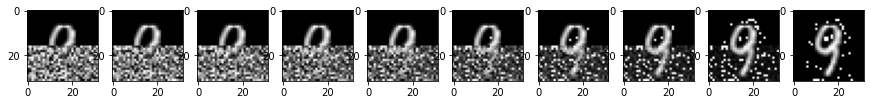

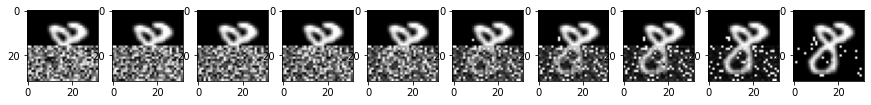

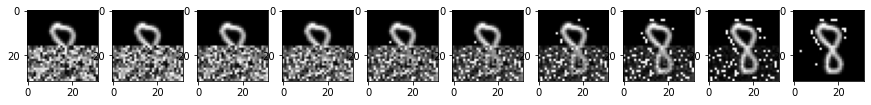

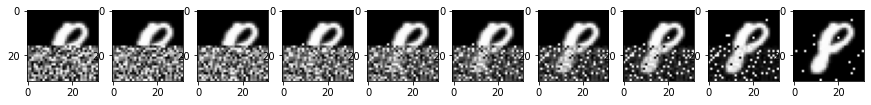

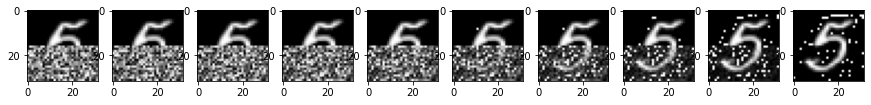

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 5 | Train Loss: 38.43367549246329 Eval Loss: 38.23525070699056 


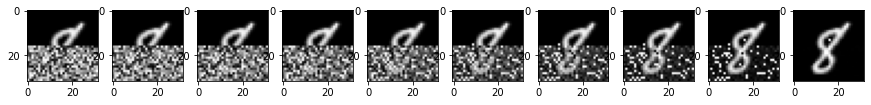

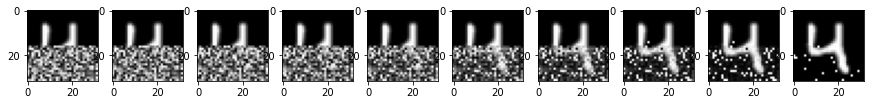

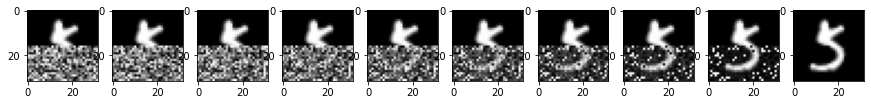

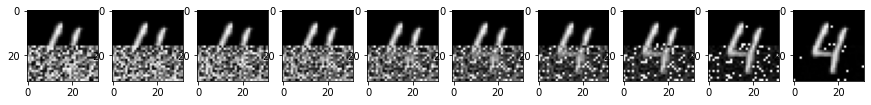

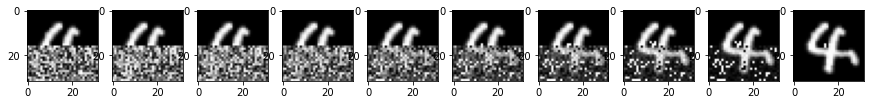

...

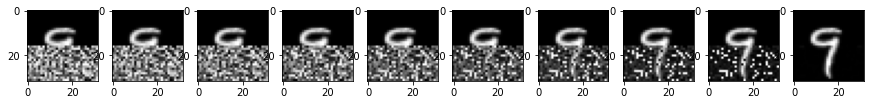

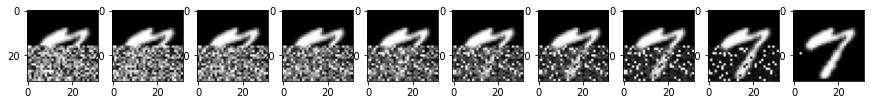

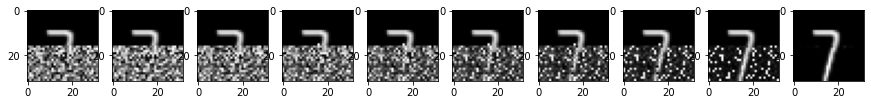

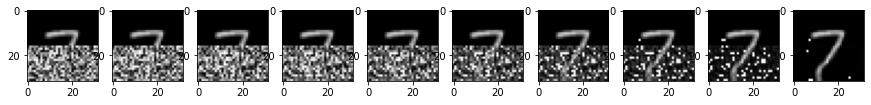

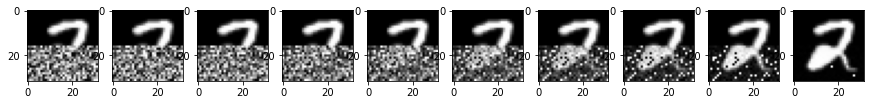

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 6 | Train Loss: 38.221210475780346 Eval Loss: 39.390754328409834 


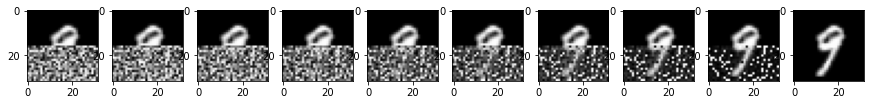

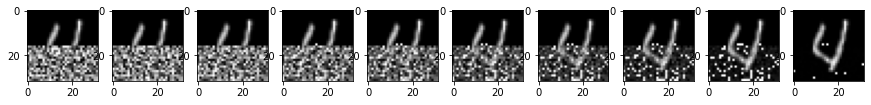

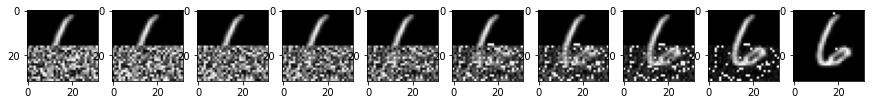

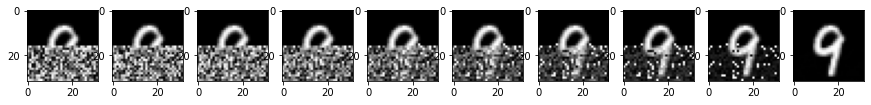

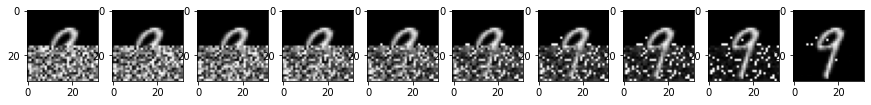

...

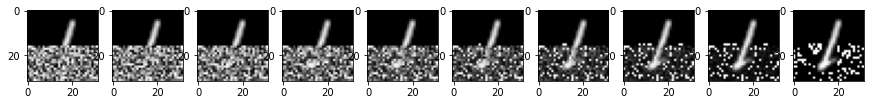

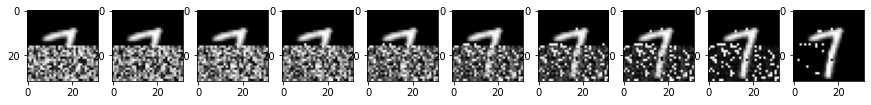

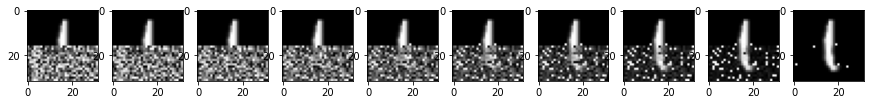

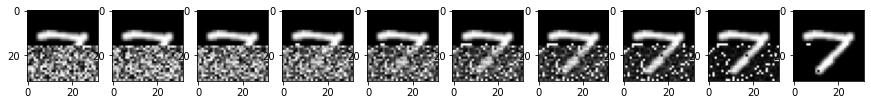

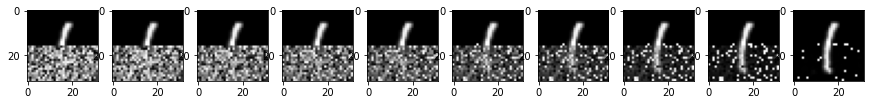

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 7 | Train Loss: 37.95142980222349 Eval Loss: 39.008585540771485 


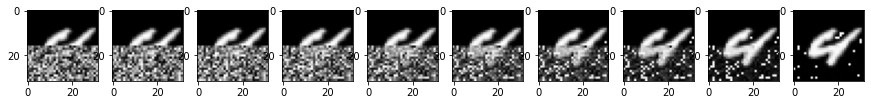

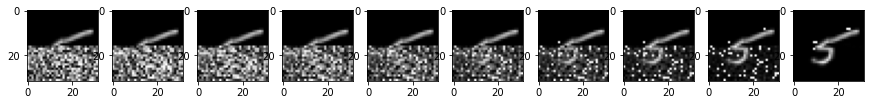

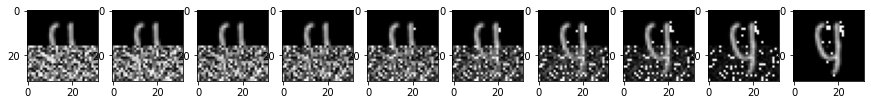

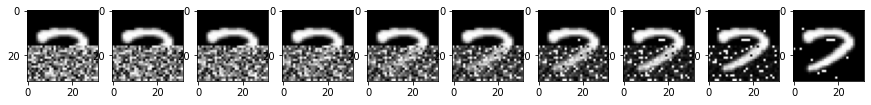

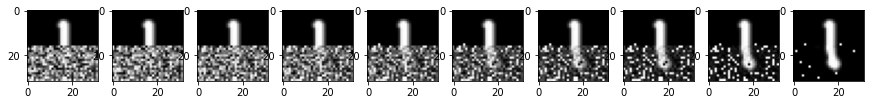

...

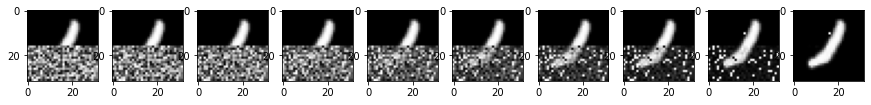

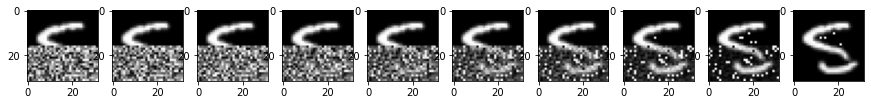

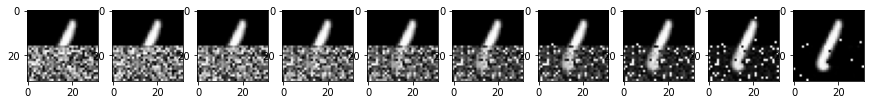

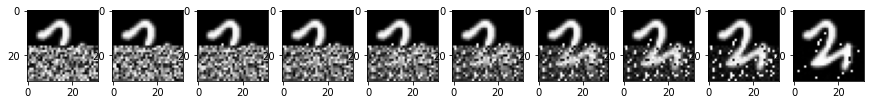

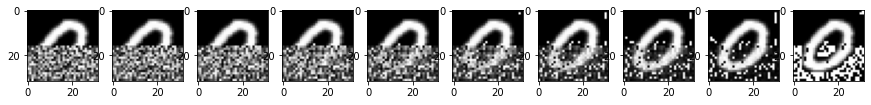

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 8 | Train Loss: 38.056586433128075 Eval Loss: 39.38424812825521 


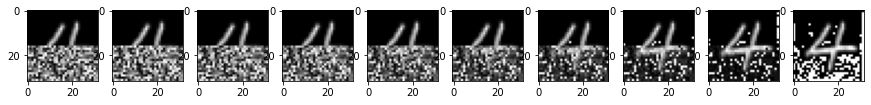

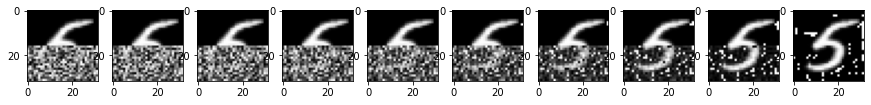

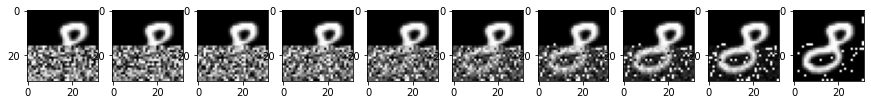

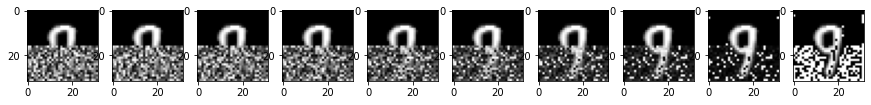

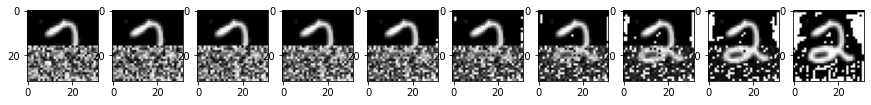

...

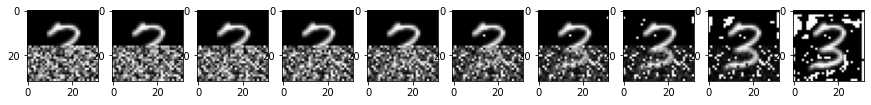

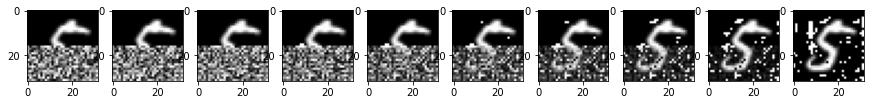

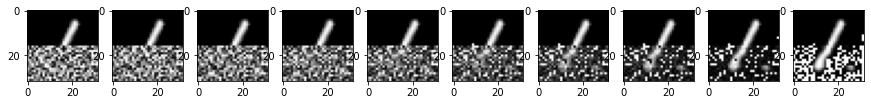

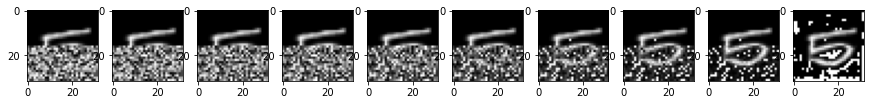

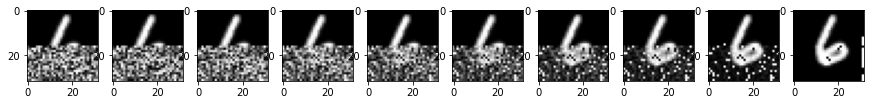

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 9 | Train Loss: 37.66840843087655 Eval Loss: 39.34954898579915 


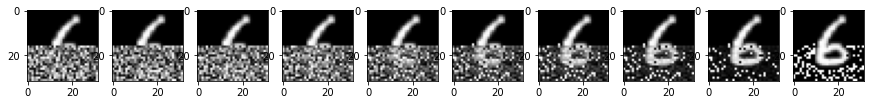

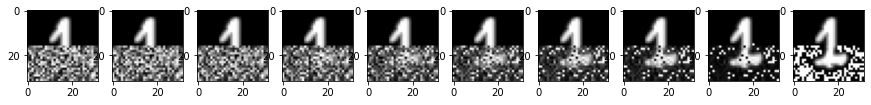

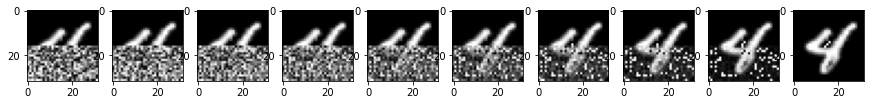

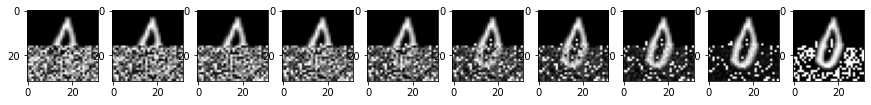

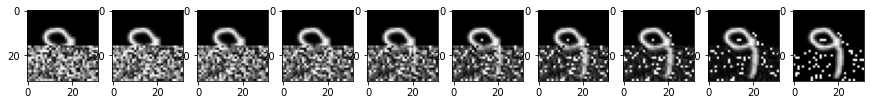

...

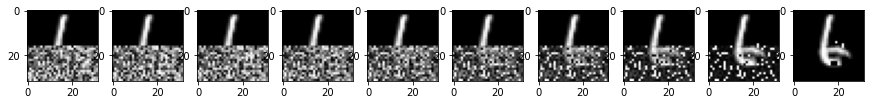

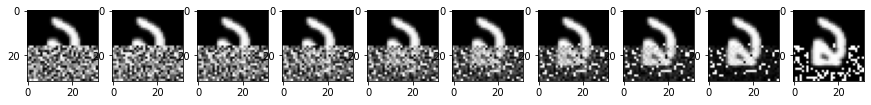

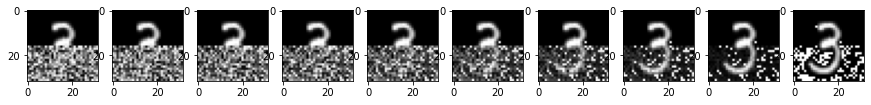

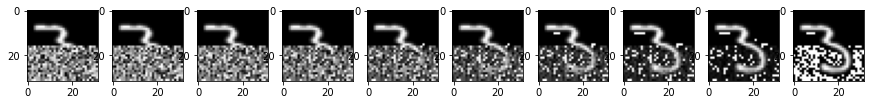

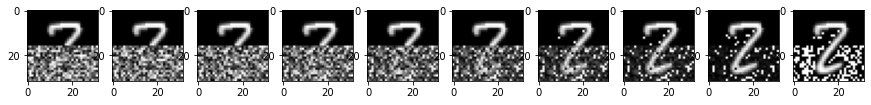

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 10 | Train Loss: 37.74080473949291 Eval Loss: 38.12002528889974 


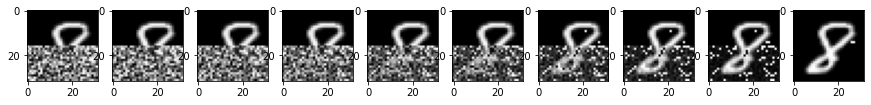

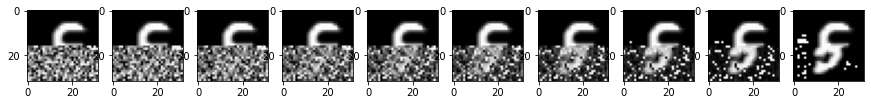

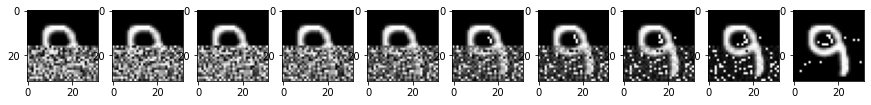

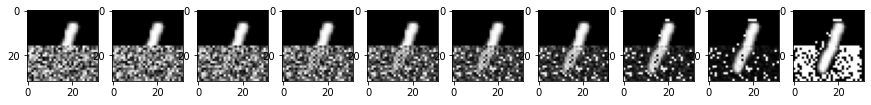

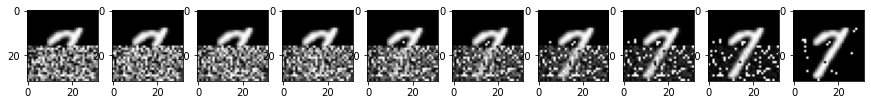

...

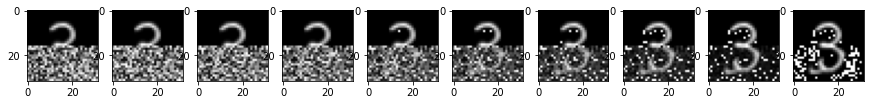

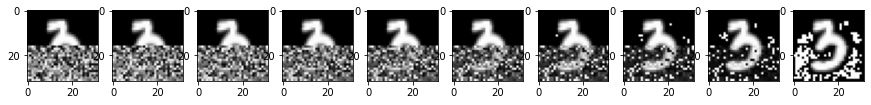

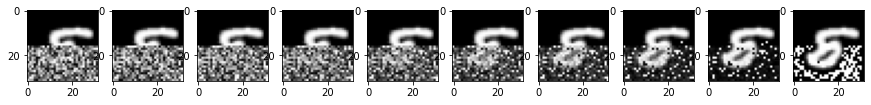

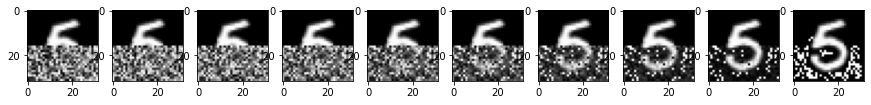

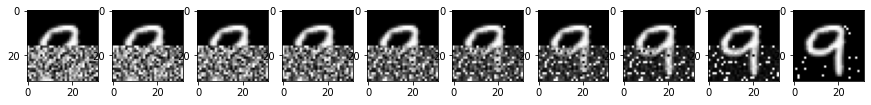

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 11 | Train Loss: 37.602156902737086 Eval Loss: 38.32472547403972 


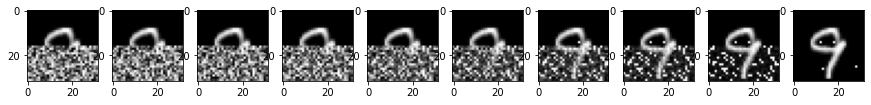

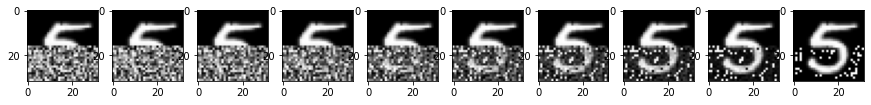

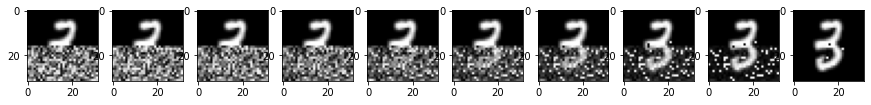

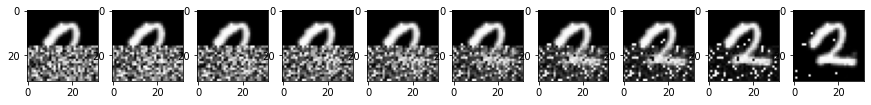

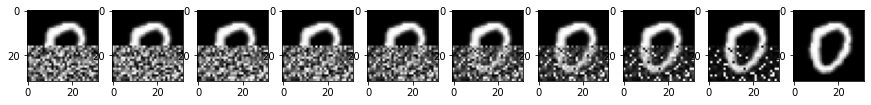

...

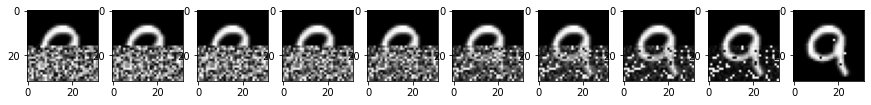

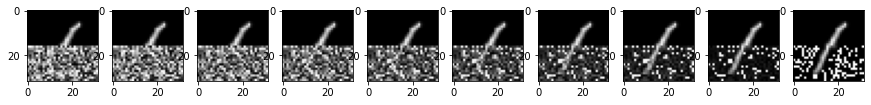

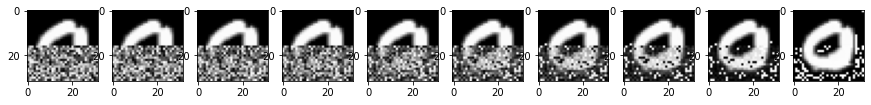

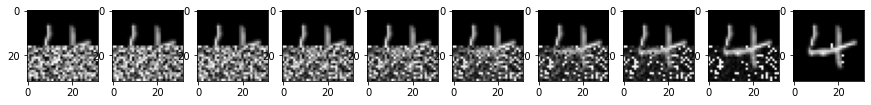

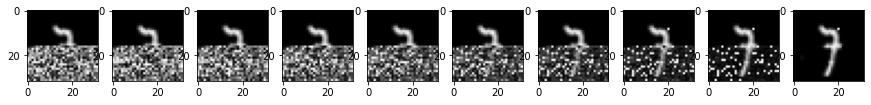

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 12 | Train Loss: 37.4271701671459 Eval Loss: 38.6906589457194 


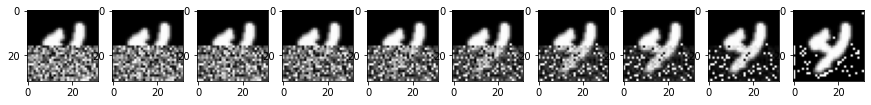

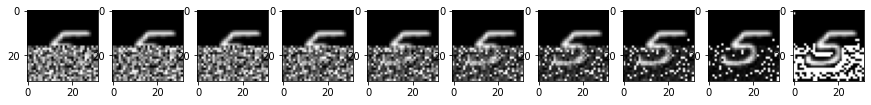

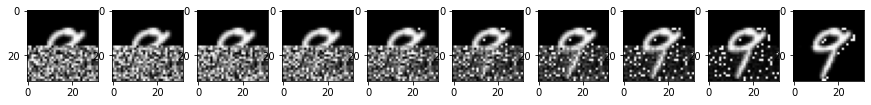

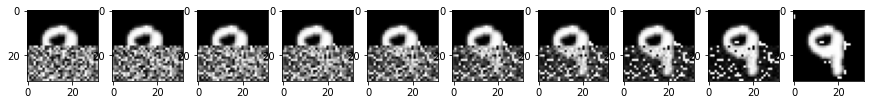

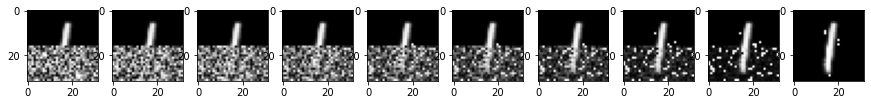

...

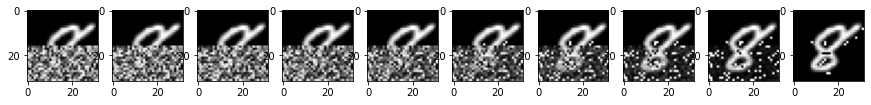

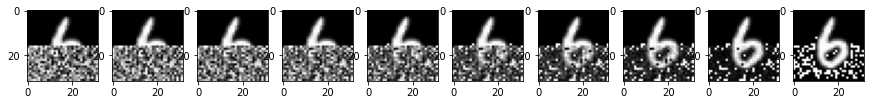

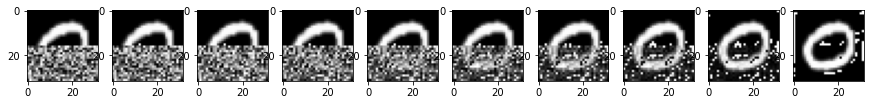

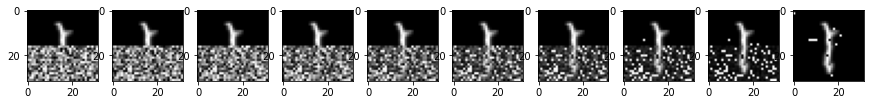

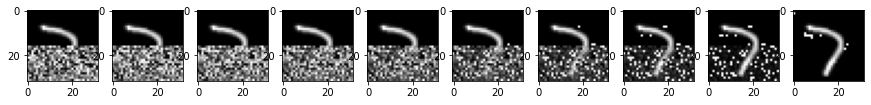

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 13 | Train Loss: 37.34045625870316 Eval Loss: 38.43533030192057 


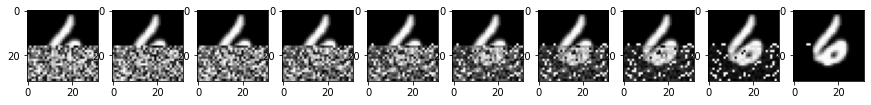

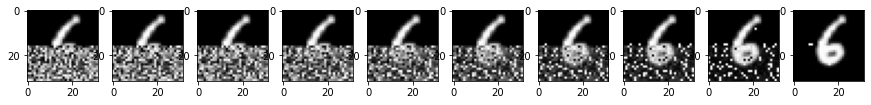

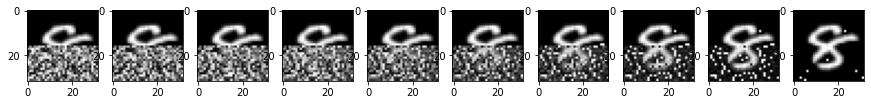

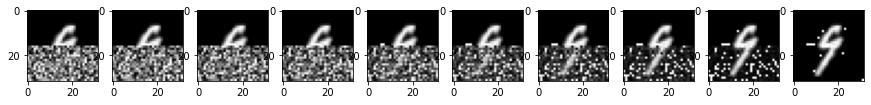

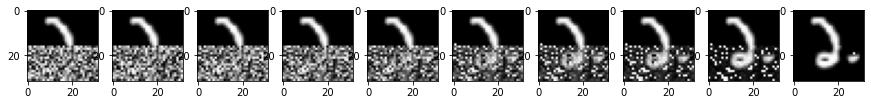

...

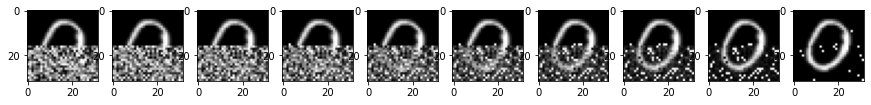

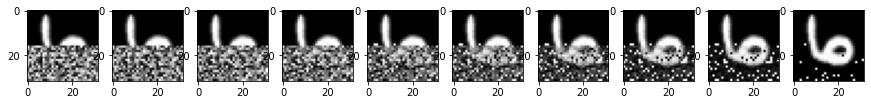

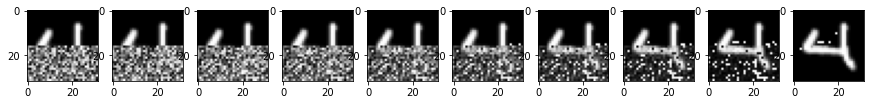

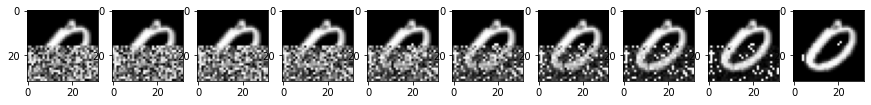

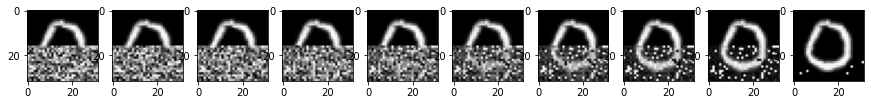

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 14 | Train Loss: 37.3979310997857 Eval Loss: 38.31363427734375 


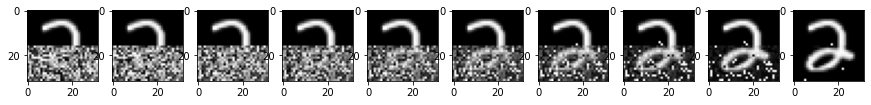

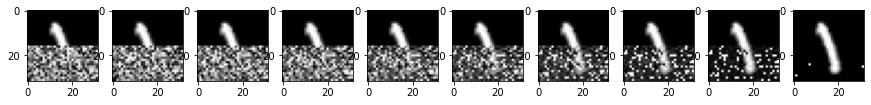

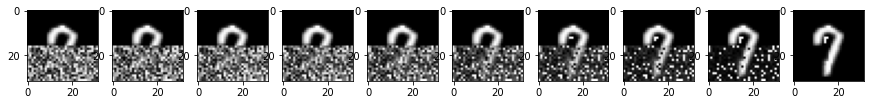

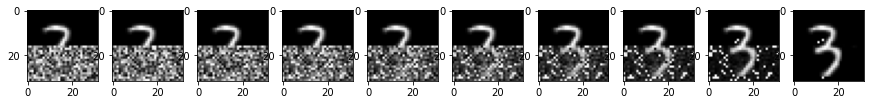

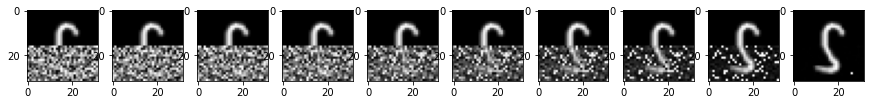

...

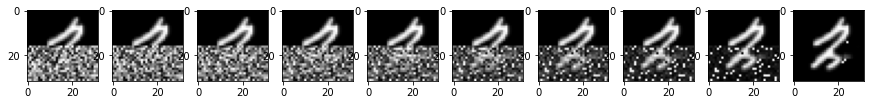

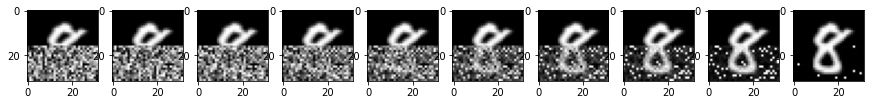

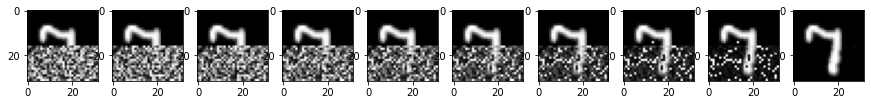

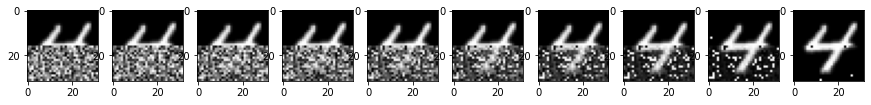

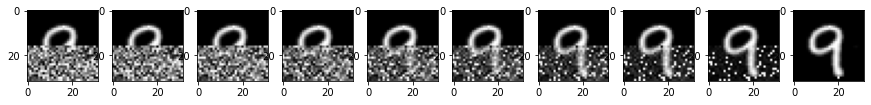

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 15 | Train Loss: 37.00387053087022 Eval Loss: 38.61761987304688 


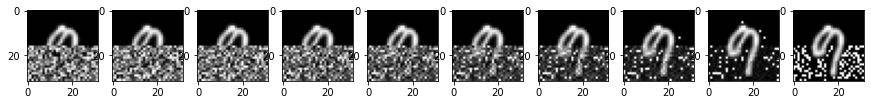

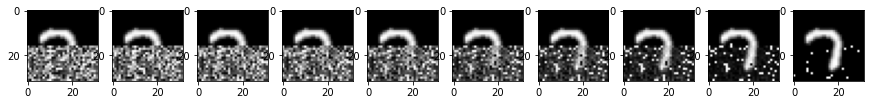

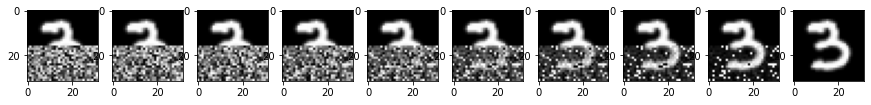

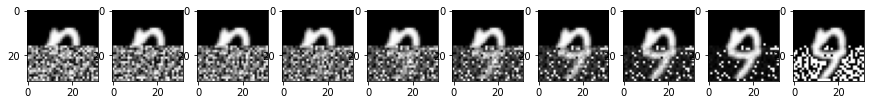

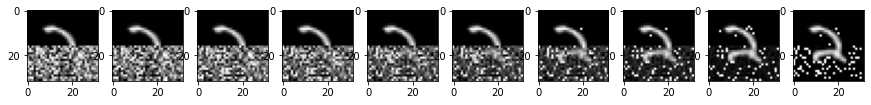

...

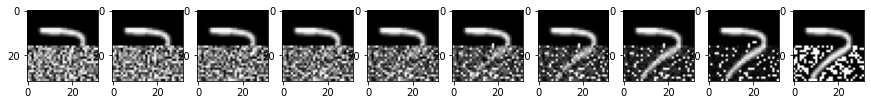

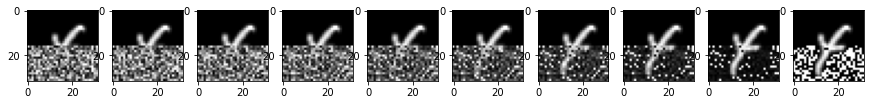

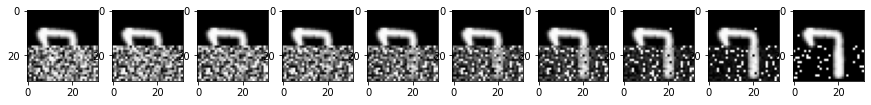

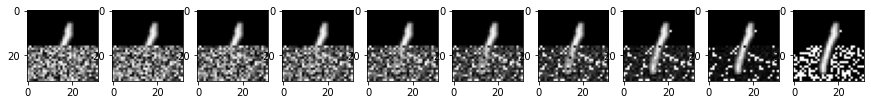

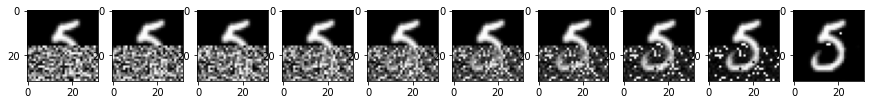

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 16 | Train Loss: 36.76019611104329 Eval Loss: 38.077238657633465 


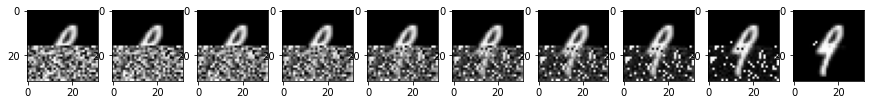

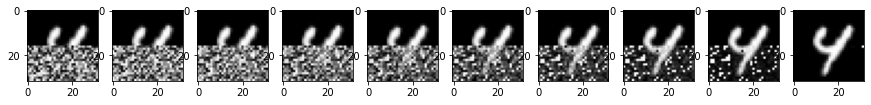

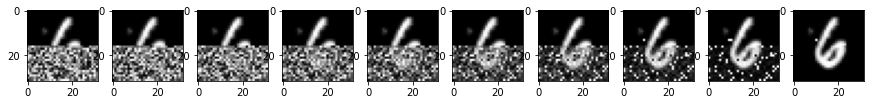

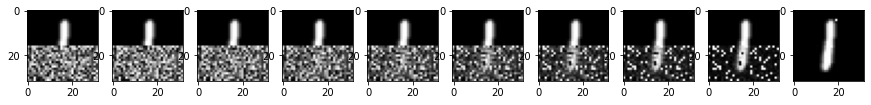

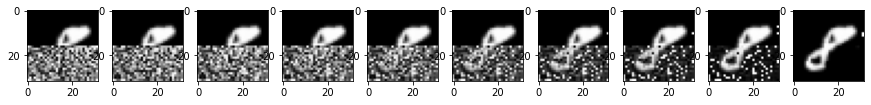

...

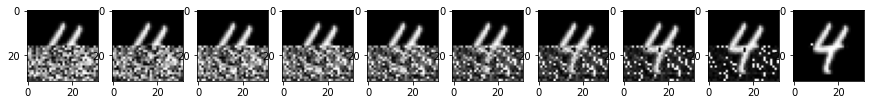

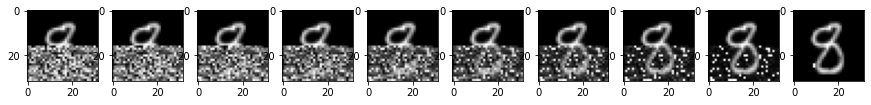

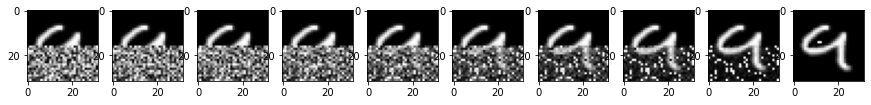

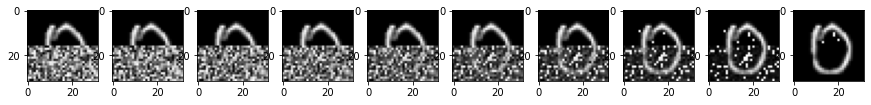

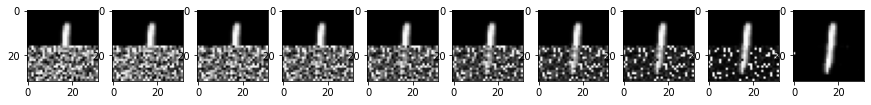

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 17 | Train Loss: 36.634827241685656 Eval Loss: 38.103746480305986 


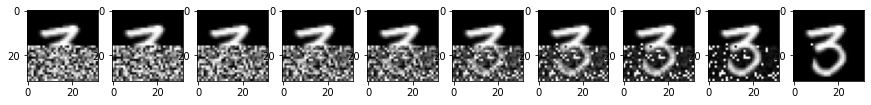

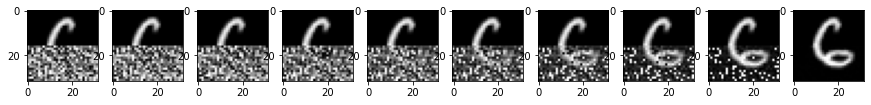

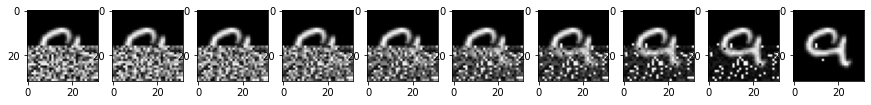

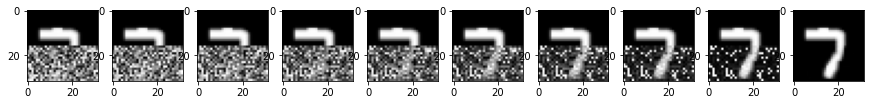

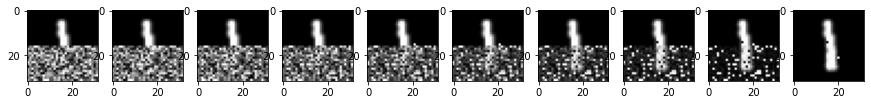

...

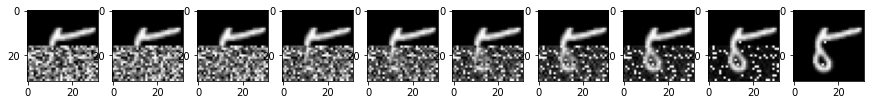

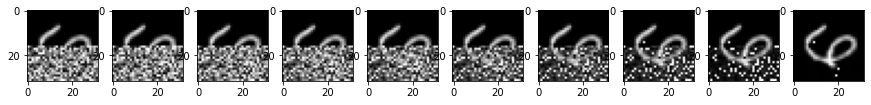

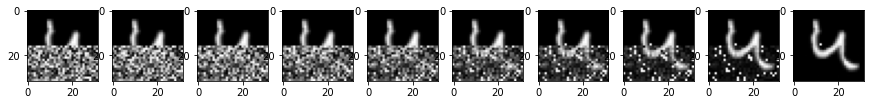

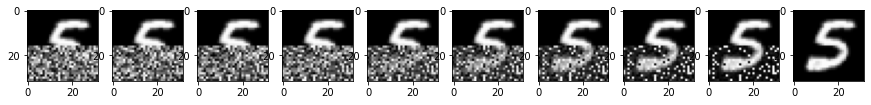

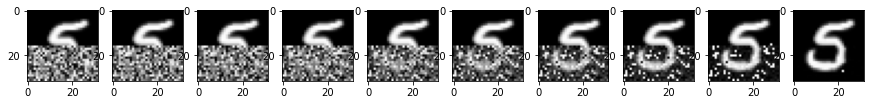

  0%|          | 0/3375 [00:00<?, ?it/s]

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch 18 | Train Loss: 36.60681276731138 Eval Loss: 37.94426334635417 


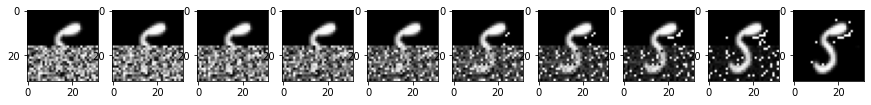

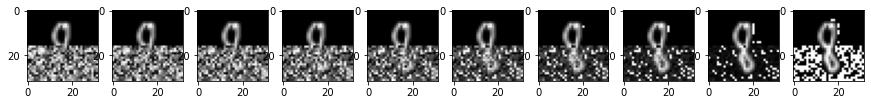

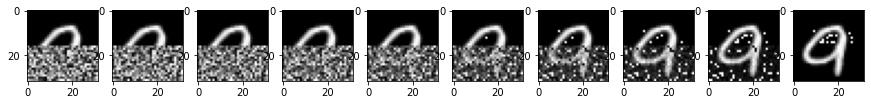

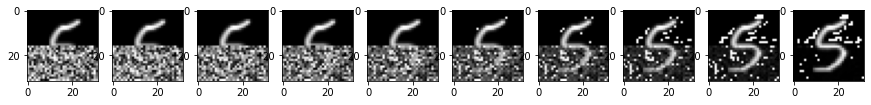

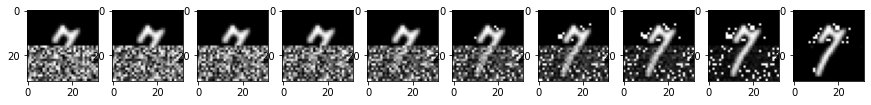

...

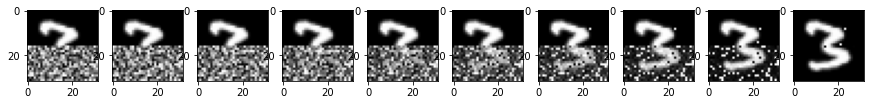

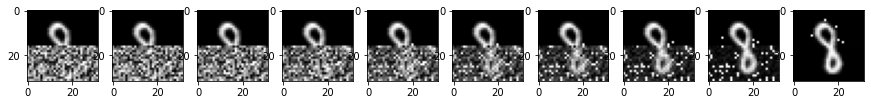

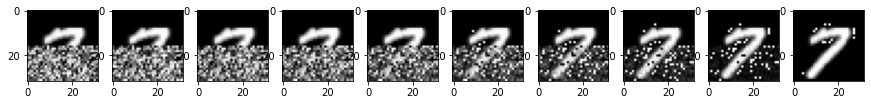

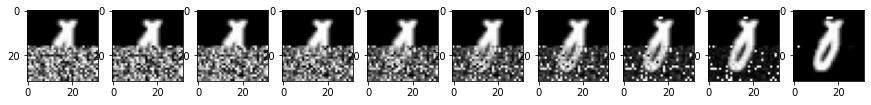

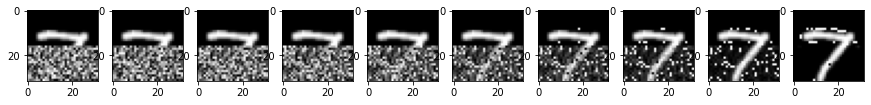

  0%|          | 0/3375 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [13]:
from torch.optim import Adam
from tqdm.auto import tqdm

device = "cuda" if torch.cuda.is_available() else "cpu"
model = torch.load("new_impaining_model_17.pt")
model.to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
epochs = 100 # Try more!

for epoch in range(epochs):
    train_loss = train_epoch(model, train_dataloader, device)
    eval_loss = eval_epoch(model, test_dataloader, device)

    if epoch % 1 == 0:
        print(f"Epoch {epoch} | Train Loss: {train_loss} Eval Loss: {eval_loss} ")
        
        eval_examples = next(iter(test_dataloader))[0].to(device)
        for i in range(eval_examples.shape[0]):
            euler_integration(model, destroy_bottom(eval_examples[i].unsqueeze(0)))
            
        torch.save(model, f"new_impaining_model_{epoch + 17}.pt")

# Sampling

In [ ]:
import torch
model = torch.load("impaining_model_5.pt")
device = "cuda"
model.to(device)
model

100%|██████████| 1000/1000 [00:26<00:00, 38.14it/s]


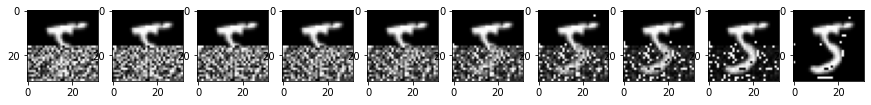

100%|██████████| 1000/1000 [00:25<00:00, 38.64it/s]


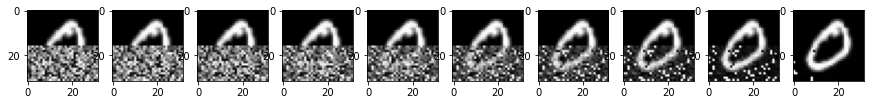

100%|██████████| 1000/1000 [00:25<00:00, 39.94it/s]


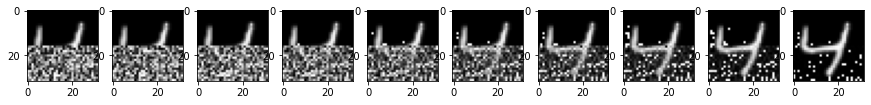

100%|██████████| 1000/1000 [00:25<00:00, 39.38it/s]


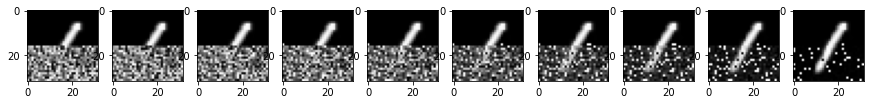

100%|██████████| 1000/1000 [00:25<00:00, 38.95it/s]


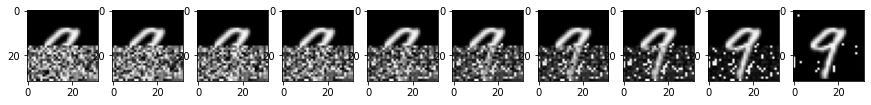

100%|██████████| 1000/1000 [00:25<00:00, 39.01it/s]


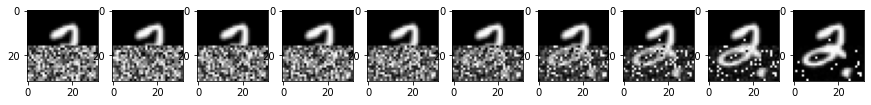

100%|██████████| 1000/1000 [00:26<00:00, 38.37it/s]


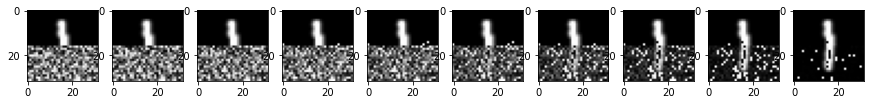

100%|██████████| 1000/1000 [00:25<00:00, 38.98it/s]


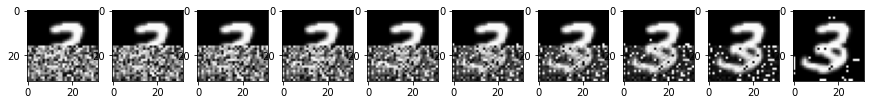

100%|██████████| 1000/1000 [00:24<00:00, 40.11it/s]


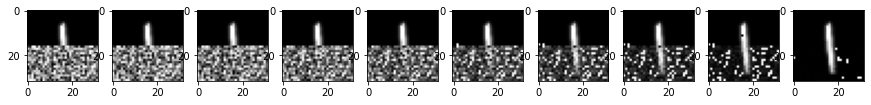

100%|██████████| 1000/1000 [00:25<00:00, 39.59it/s]


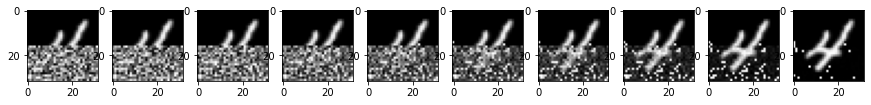

100%|██████████| 1000/1000 [00:25<00:00, 38.71it/s]


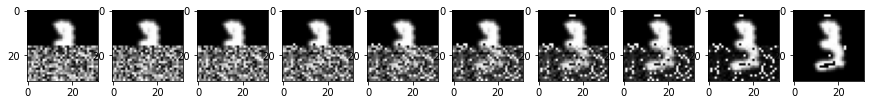

100%|██████████| 1000/1000 [00:25<00:00, 38.69it/s]


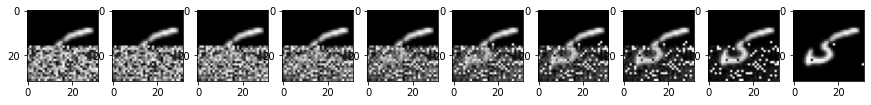

100%|██████████| 1000/1000 [00:25<00:00, 38.50it/s]


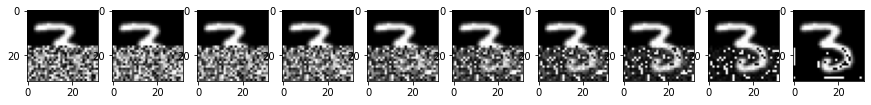

100%|██████████| 1000/1000 [00:24<00:00, 40.03it/s]


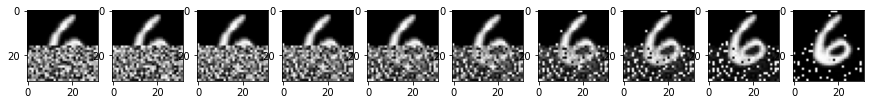

100%|██████████| 1000/1000 [00:25<00:00, 38.62it/s]


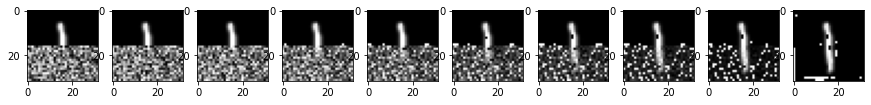

100%|██████████| 1000/1000 [00:25<00:00, 39.28it/s]


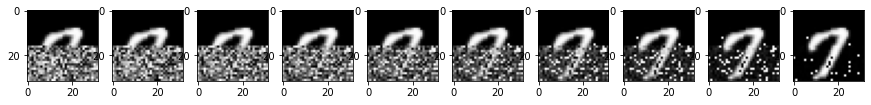

100%|██████████| 1000/1000 [00:25<00:00, 39.88it/s]


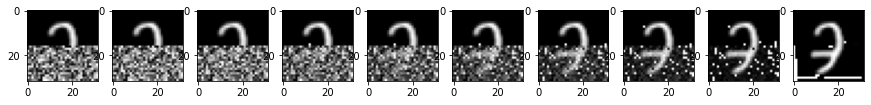

100%|██████████| 1000/1000 [00:25<00:00, 38.88it/s]


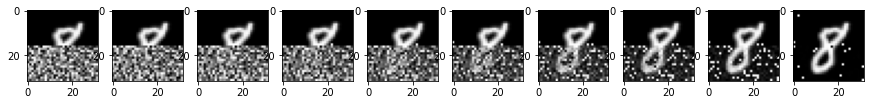

100%|██████████| 1000/1000 [00:25<00:00, 39.13it/s]


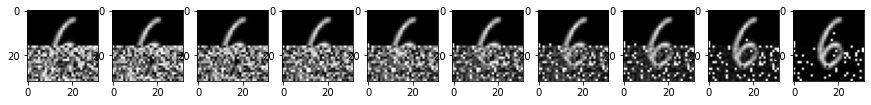

100%|██████████| 1000/1000 [00:25<00:00, 38.69it/s]


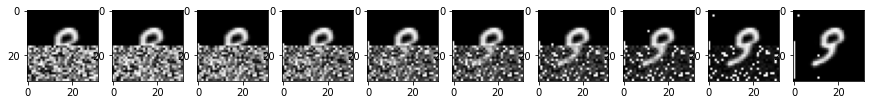

In [13]:
from tqdm import tqdm

for i in range(20):
    euler_integration(model, destroy_bottom(dataset[i][0].to("cuda").unsqueeze(0)))